<a href="https://colab.research.google.com/github/visualdatabase/fastdup/blob/main/examples/fastdup_tensorboard.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Fastdup Tutorial

[Visit our GitHub Project Page](https://github.com/visualdatabase/fastdup)

## Install fastdup

In [1]:
!pip install -U fastdup

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 39.2 MB 1.7 MB/s 


In [2]:
import fastdup

In [3]:
fastdup.__version__

'0.104'

## Download the food-101 dataset

Note that this dataset contains 101,000 images, we can run fully analyze it with fastdup on a weak Colab free notebook in about 10 minutes using a single core, without a GPU! If you like to speed up the execution you should switch to a stronger machine.

In [4]:
!wget http://data.vision.ee.ethz.ch/cvl/food-101.tar.gz

--2022-07-06 03:35:56--  http://data.vision.ee.ethz.ch/cvl/food-101.tar.gz
Resolving data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)... 129.132.52.178, 2001:67c:10ec:36c2::178
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://data.vision.ee.ethz.ch/cvl/food-101.tar.gz [following]
--2022-07-06 03:35:57--  https://data.vision.ee.ethz.ch/cvl/food-101.tar.gz
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4996278331 (4.7G) [application/x-gzip]
Saving to: ‘food-101.tar.gz’

food-101.tar.gz     100%[===================>]   4.65G  25.0MB/s    in 3m 16s  

2022-07-06 03:39:13 (24.3 MB/s) - ‘food-101.tar.gz’ saved [4996278331/4996278331]



In [5]:
!tar xzf food-101.tar.gz

## Run fastdup to gain insights from your data

In [6]:
!python -c "import fastdup; fastdup.run('food-101',verbose=0)" 

FastDup Software, (C) copyright 2022 Dr. Amir Alush and Dr. Danny Bickson.
On Jupyter notebook running on large datasets, there may be delay getting the console output. We recommend running using python shell.
Going to loop over dir food-101
Found total 101000 images to run on
Wrote total of 101000 features atrain_, found 0 bad images
Found total 101000 images to run on
195) Finished write_index() NN model
Stored nn model index file ./nnf.index
1657079979 : INFO:     (add_vertices:460): Num vertices for group 0: 101000
1657079979 : INFO:     (commit_edge_buffer:609): In commit edge buffer (0,0)
1657079979 : INFO:     (commit_edge_buffer:680): Shuffling edges ...
1657079979 : INFO:     (commit_edge_buffer:688): Done shuffling edges in 0.024808 secs
1657079979 : INFO:     (commit_edge_buffer:692): Aggregating unique vertices...
1657079979 : INFO:     (commit_edge_buffer:705): Done aggregating unique vertex in 0.005464 secs
1657079979 : INFO:     (commit_edge_buffer:713): Combine vertex d

In [7]:
fastdup.create_duplicates_gallery('similarity.csv',save_path='.', num_images=20)

100%|██████████| 20/20 [00:00<00:00, 46.00it/s]


Stored similarity visual view in  ./similarity.html


,Image,Distance,From,To
0,,1.0,food-101/images/churros/2547960.jpg,food-101/images/churros/2617186.jpg
1,,1.0,food-101/images/chicken_wings/820377.jpg,food-101/images/chicken_wings/834669.jpg
2,,1.0,food-101/images/french_onion_soup/1741871.jpg,food-101/images/french_onion_soup/1741875.jpg
3,,1.0,food-101/images/foie_gras/1721369.jpg,food-101/images/foie_gras/1721540.jpg
4,,1.0,food-101/images/breakfast_burrito/662420.jpg,food-101/images/breakfast_burrito/662423.jpg
5,,1.0,food-101/images/chicken_quesadilla/1579819.jpg,food-101/images/chicken_quesadilla/1590716.jpg
6,,1.0,food-101/images/breakfast_burrito/662420.jpg,food-101/images/breakfast_burrito/662424.jpg
7,,1.0,food-101/images/breakfast_burrito/662423.jpg,food-101/images/breakfast_burrito/662424.jpg
9,,1.0,food-101/images/falafel/3572759.jpg,food-101/images/falafel/3882357.jpg
10,,1.0,food-101/images/fried_rice/2820757.jpg,food-101/images/fried_rice/2899815.jpg

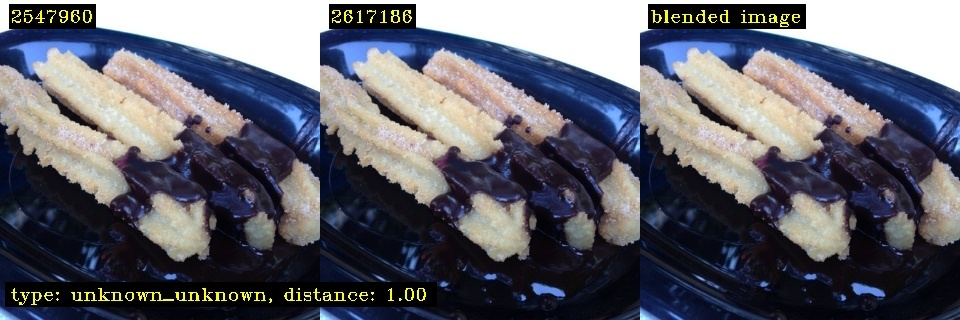
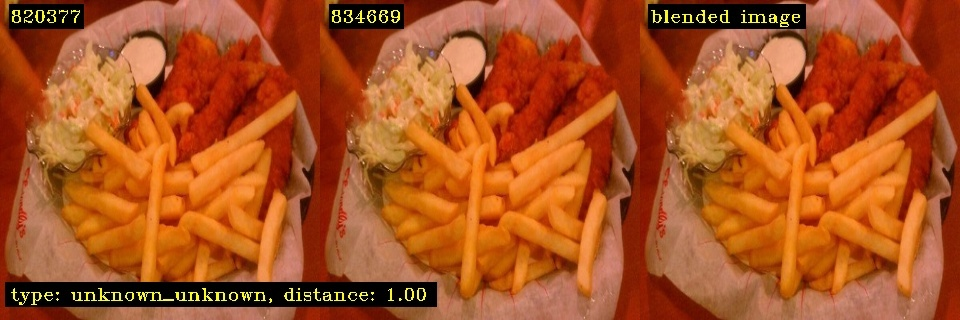
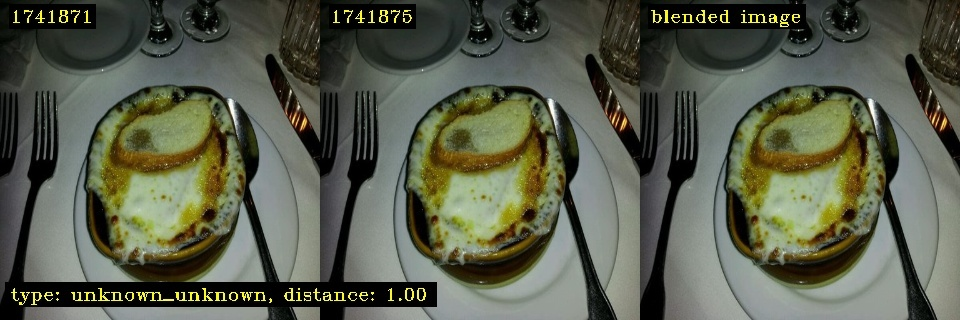
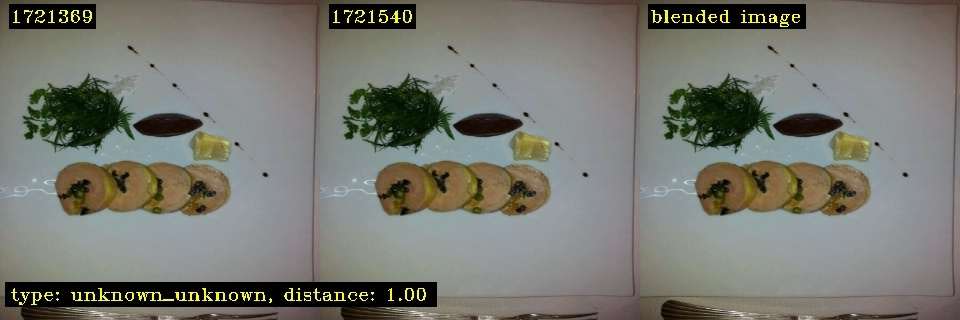
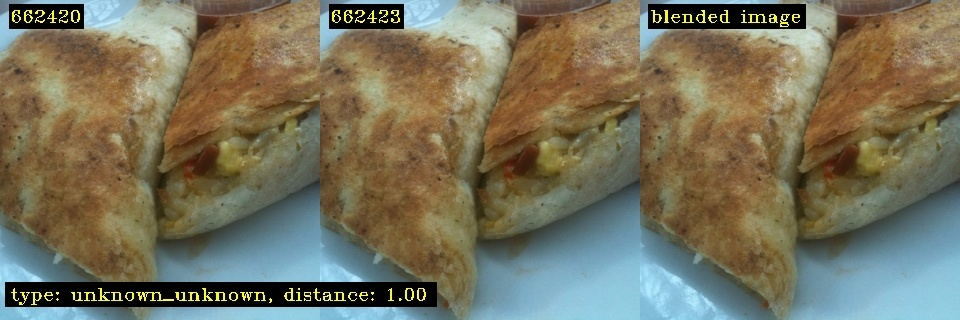
...
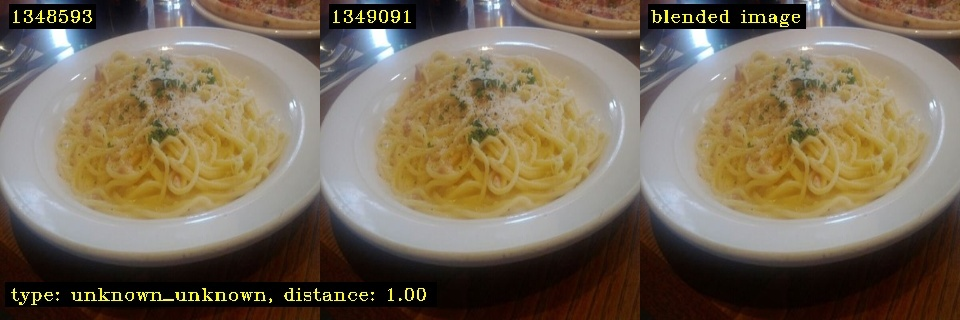
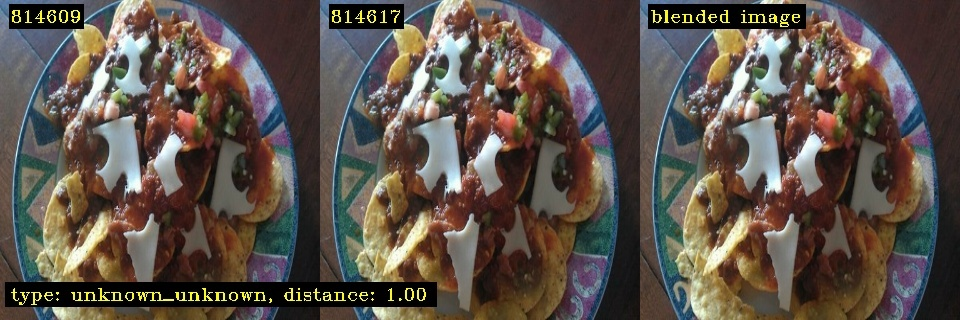
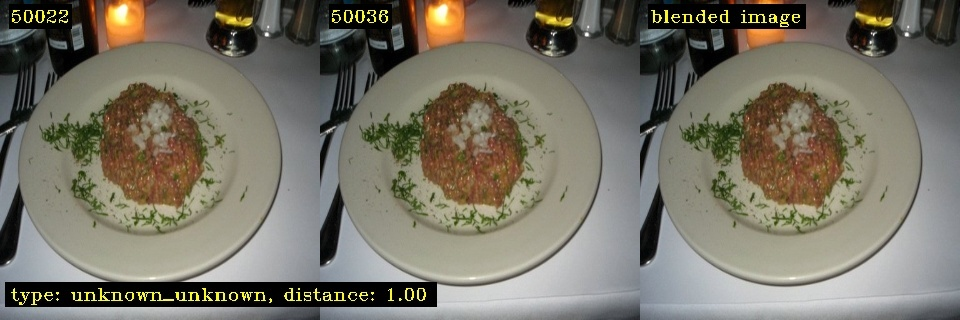
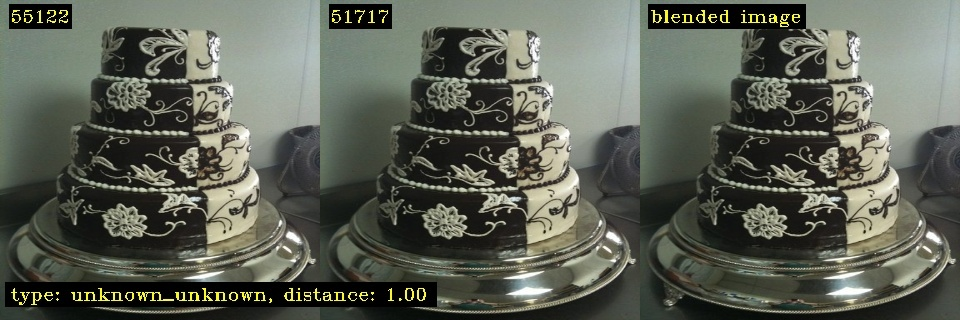
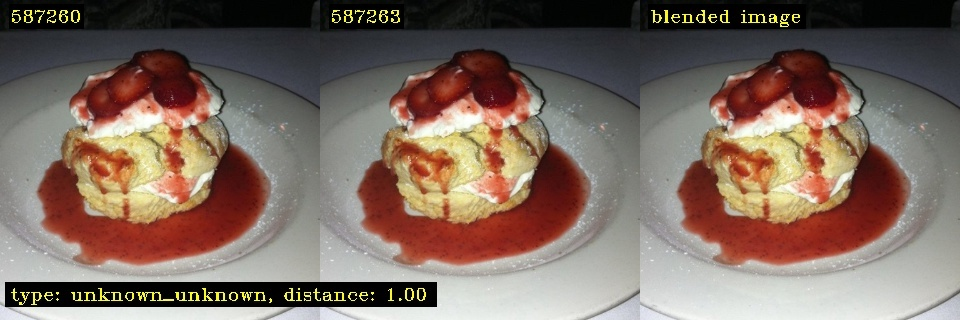

In [8]:
from IPython.display import HTML
HTML('similarity.html')

In [9]:
fastdup.create_outliers_gallery('outliers.csv',save_path='.', num_images=20)

100%|██████████| 20/20 [00:00<00:00, 73.21it/s]


Stored outliers visual view in  ./outliers.html


,Image,Distance,Path
10099,,0.112212,food-101/images/breakfast_burrito/462294.jpg
10097,,0.428721,food-101/images/macarons/2117640.jpg
10095,,0.515787,food-101/images/tacos/1505262.jpg
10094,,0.528563,food-101/images/shrimp_and_grits/1047420.jpg
10093,,0.546918,food-101/images/sushi/3100962.jpg
10090,,0.573438,food-101/images/pho/2399877.jpg
10089,,0.573612,food-101/images/prime_rib/587532.jpg
10088,,0.574433,food-101/images/pho/1840846.jpg
10087,,0.576987,food-101/images/chocolate_cake/2518457.jpg
10085,,0.580771,food-101/images/macarons/2591602.jpg

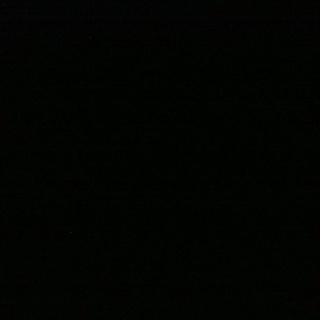
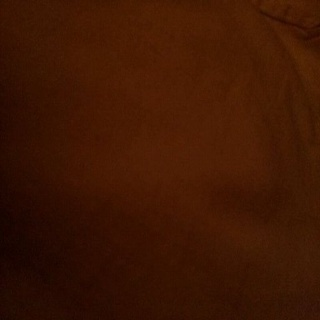
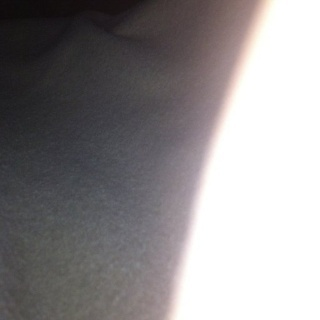
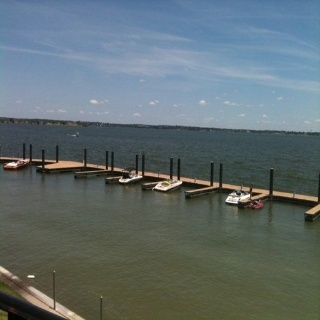
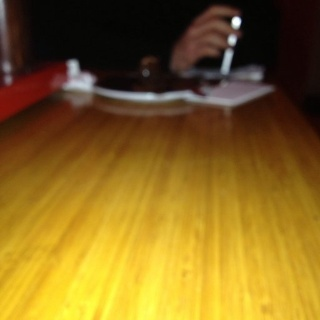
...
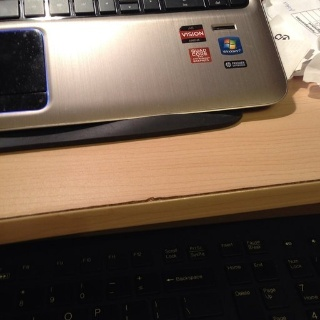
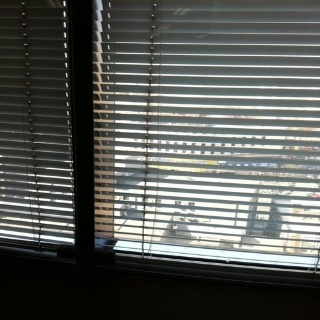
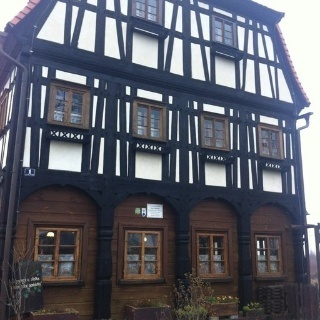
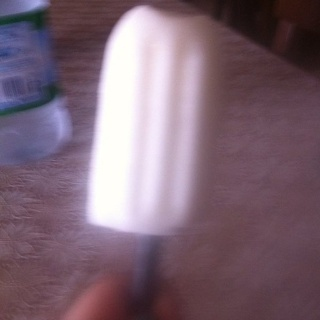
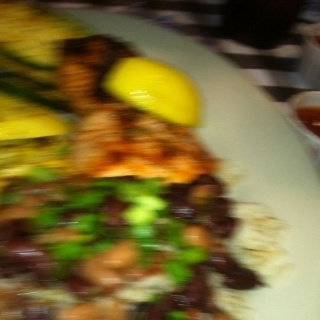

In [10]:
HTML('outliers.html')

## Perform graph analytics to find connected components of images

Connected components are clusters of similar images. In the code below we find the largest clusters of duplicate images and visualize them.

0it [00:00, ?it/s]
100%|██████████| 3/3 [00:00<00:00, 320.98it/s]
1it [00:08,  8.27s/it]
100%|██████████| 3/3 [00:00<00:00, 2622.53it/s]
2it [00:08,  3.53s/it]
100%|██████████| 3/3 [00:00<00:00, 2016.49it/s]
3it [00:08,  2.07s/it]
100%|██████████| 2/2 [00:00<00:00, 2108.22it/s]
4it [00:09,  1.39s/it]
100%|██████████| 2/2 [00:00<00:00, 1834.78it/s]
5it [00:09,  1.04it/s]
100%|██████████| 2/2 [00:00<00:00, 2470.14it/s]
6it [00:09,  1.48it/s]
100%|██████████| 2/2 [00:00<00:00, 2110.34it/s]

100%|██████████| 2/2 [00:00<00:00, 1234.34it/s]
8it [00:09,  2.30it/s]
100%|██████████| 2/2 [00:00<00:00, 1980.31it/s]
9it [00:10,  2.53it/s]
100%|██████████| 2/2 [00:00<00:00, 2326.29it/s]
10it [00:10,  3.04it/s]
100%|██████████| 2/2 [00:00<00:00, 2410.52it/s]
11it [00:10,  3.56it/s]
100%|██████████| 2/2 [00:00<00:00, 2549.73it/s]
12it [00:10,  3.78it/s]
100%|██████████| 2/2 [00:00<00:00, 2510.06it/s]
13it [00:10,  4.13it/s]
100%|██████████| 2/2 [00:00<00:00, 1888.48it/s]
14it [00:11,  4.24it/s]
100%|

Finished OK. Components are stored as image files components{i}.png
       component_id  \
24634         24666   
18064         18083   
34836         34878   
7088           7092   
41144         41190   

                                                                                                                                                  files  \
24634  [food-101/images/chicken_quesadilla/2388429.jpg, food-101/images/chicken_quesadilla/3004094.jpg, food-101/images/chicken_quesadilla/3779974.jpg]   
18064                    [food-101/images/chocolate_cake/49494.jpg, food-101/images/chocolate_cake/51717.jpg, food-101/images/chocolate_cake/55122.jpg]   
34836        [food-101/images/breakfast_burrito/662420.jpg, food-101/images/breakfast_burrito/662423.jpg, food-101/images/breakfast_burrito/662424.jpg]   
7088                                                               [food-101/images/beef_tartare/2030970.jpg, food-101/images/beef_tartare/2030974.jpg]   
41144             

100%|██████████| 20/20 [00:01<00:00, 17.44it/s]


Stored components visual view in  ./components.html


,component_id,num_images,image
0,24666,3,
1,18083,3,
2,34878,3,
3,7092,2,
4,41190,2,
5,100245,2,
6,50149,2,
7,985,2,
8,3580,2,
9,11944,2,

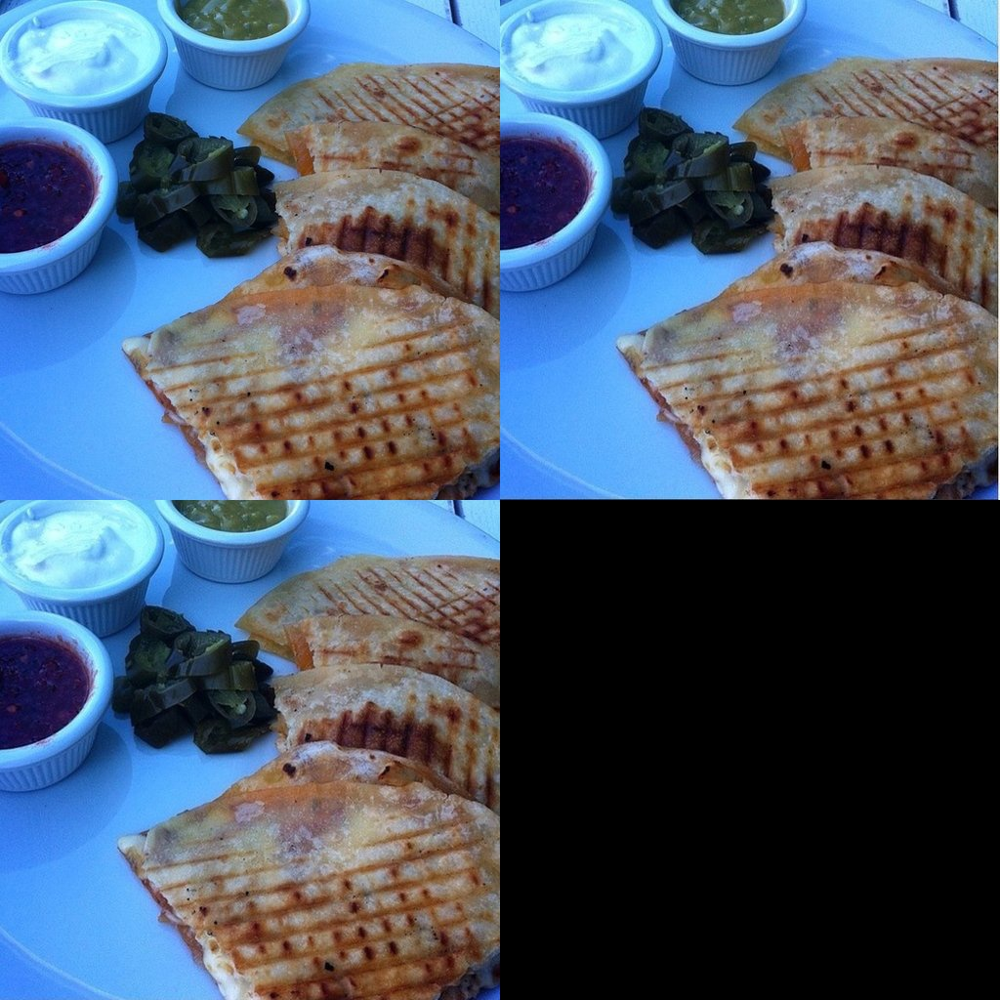
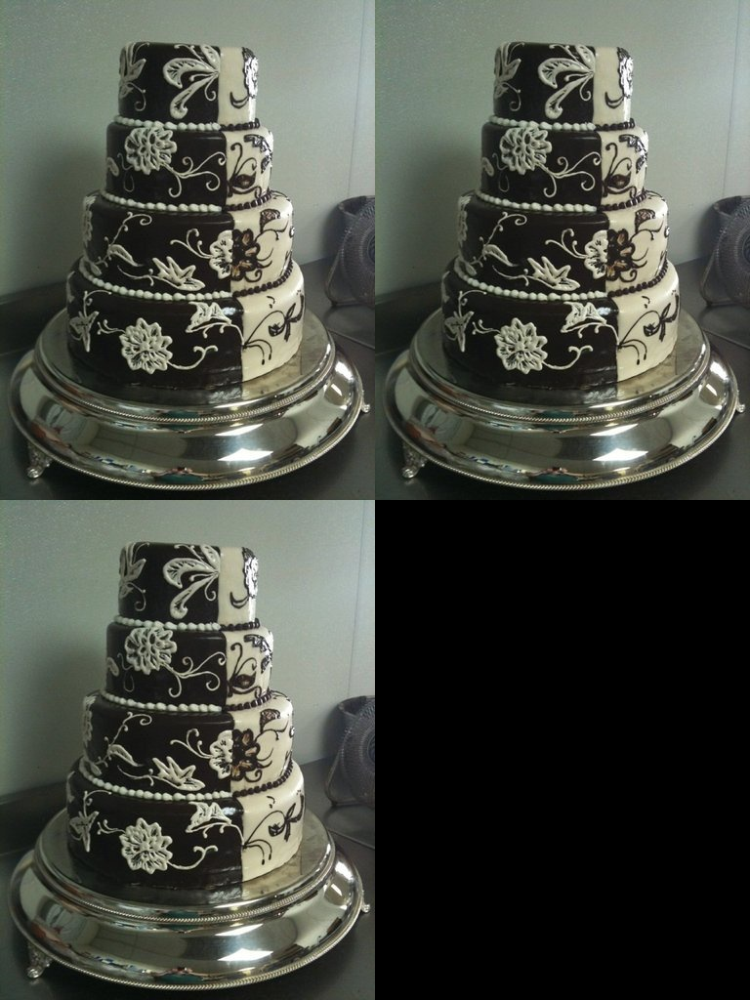
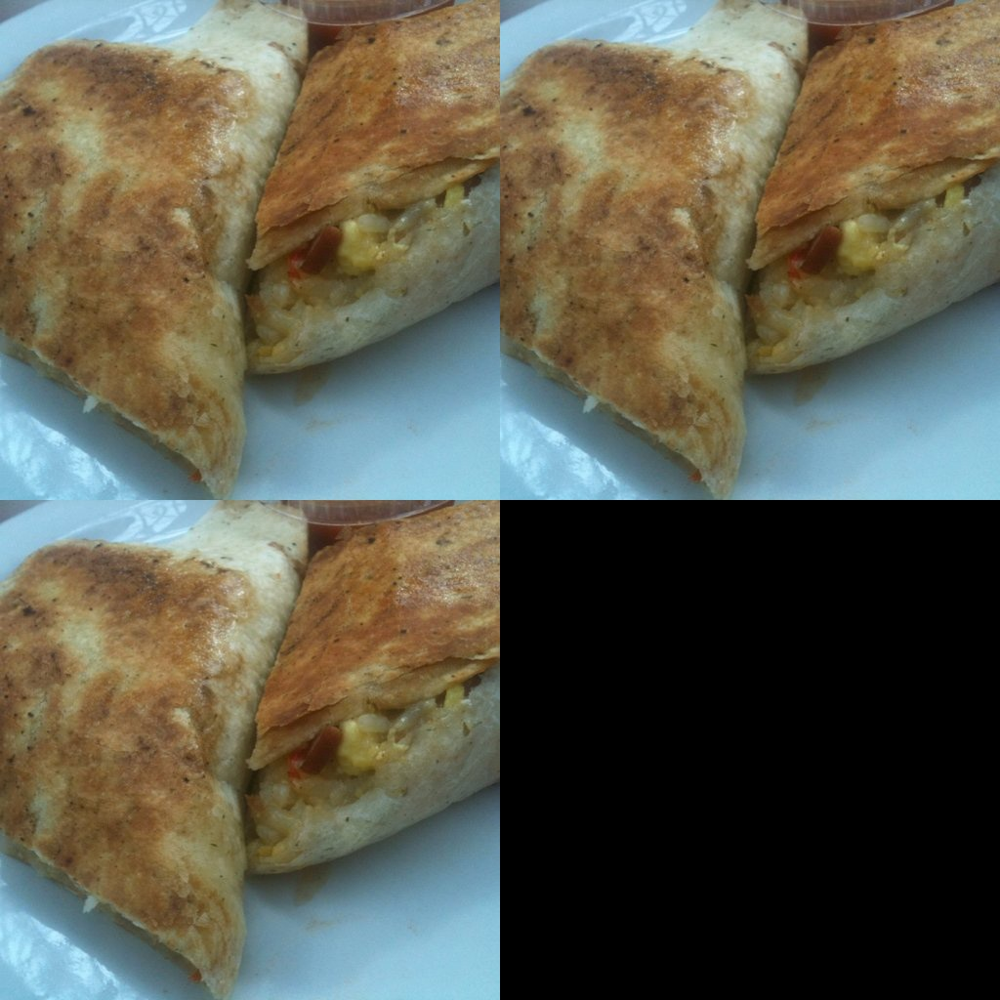
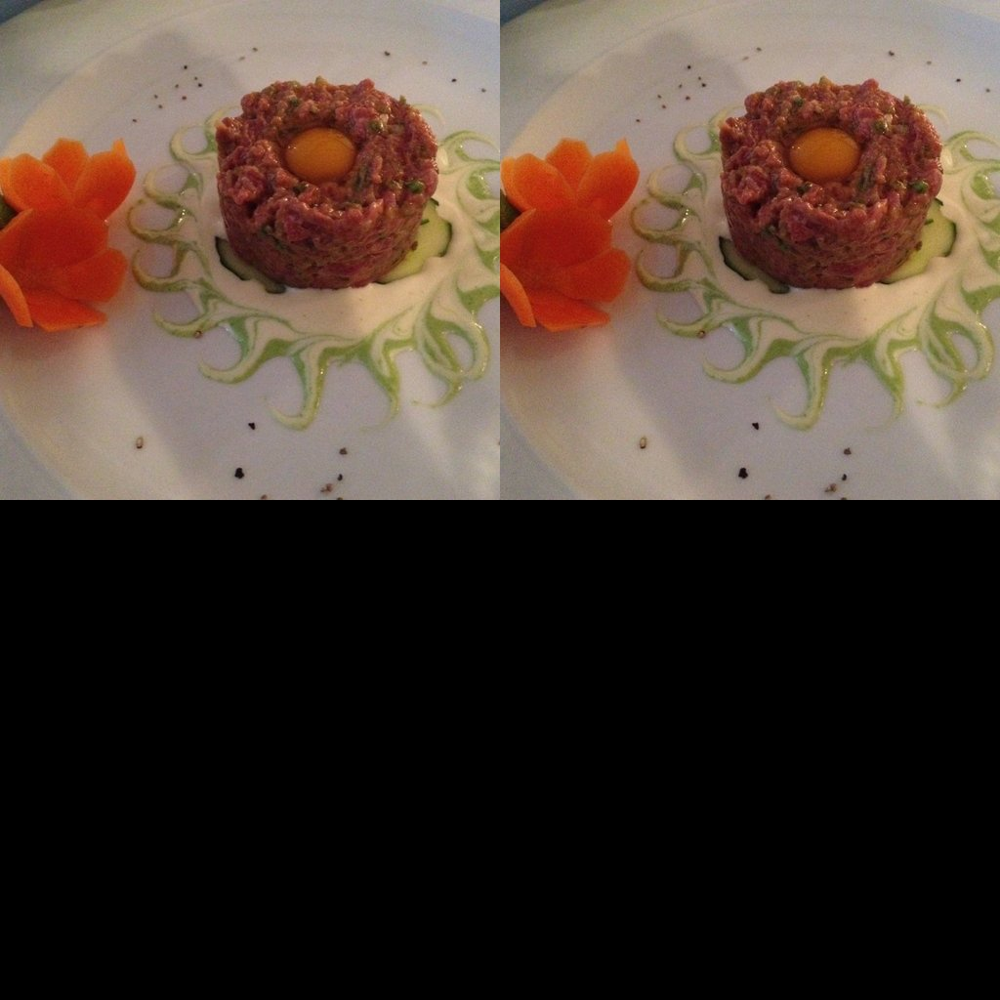
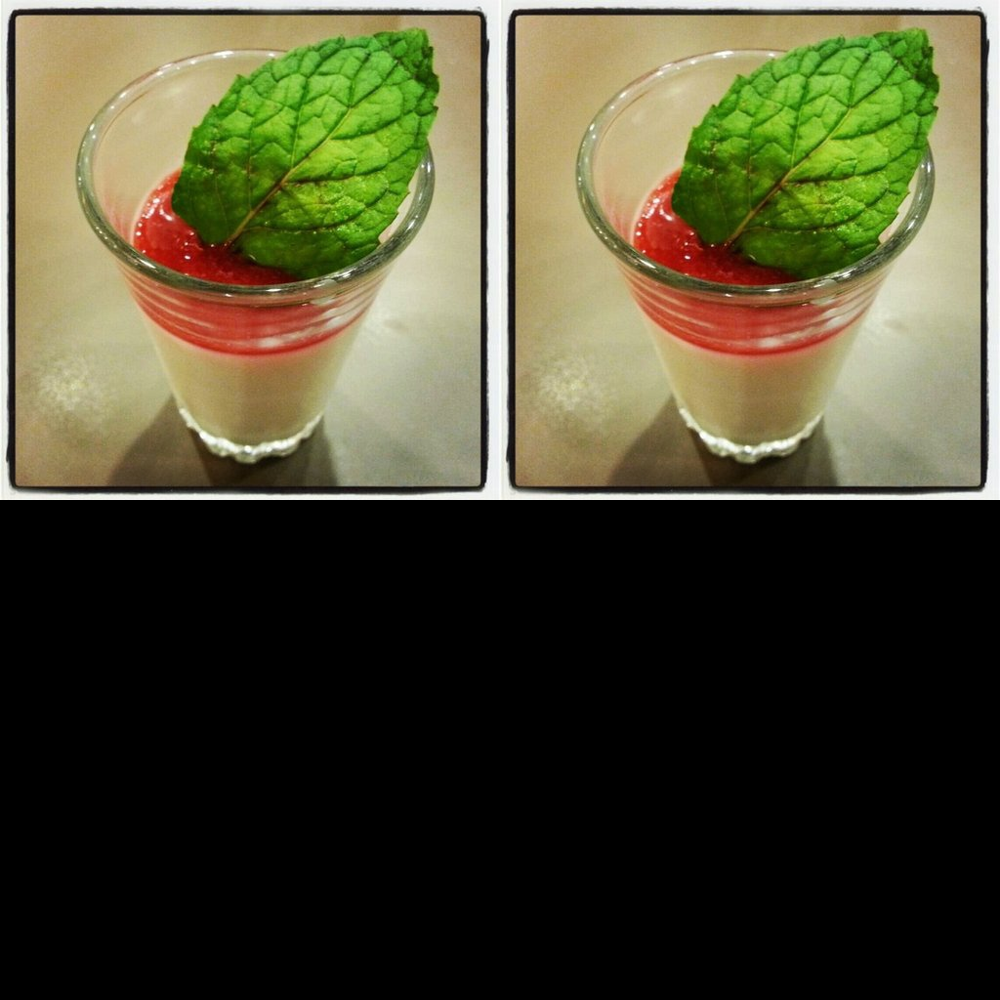
...
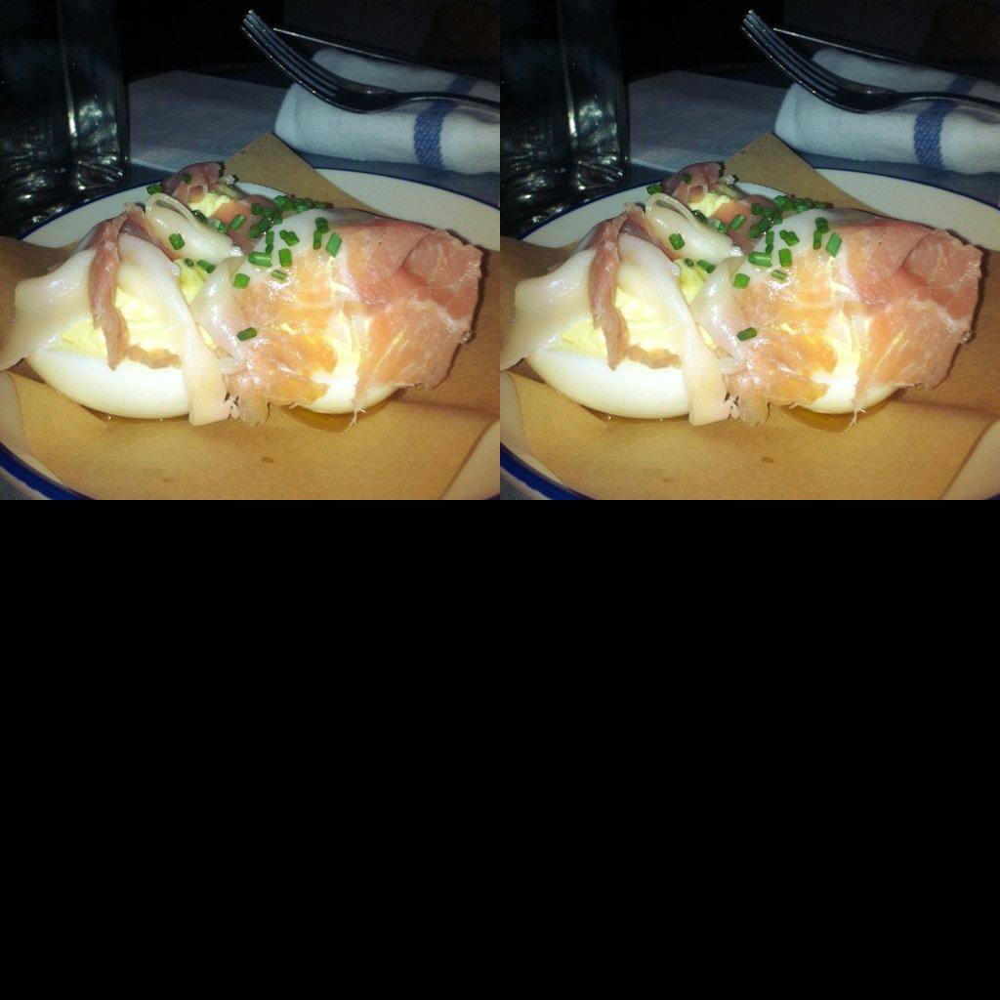
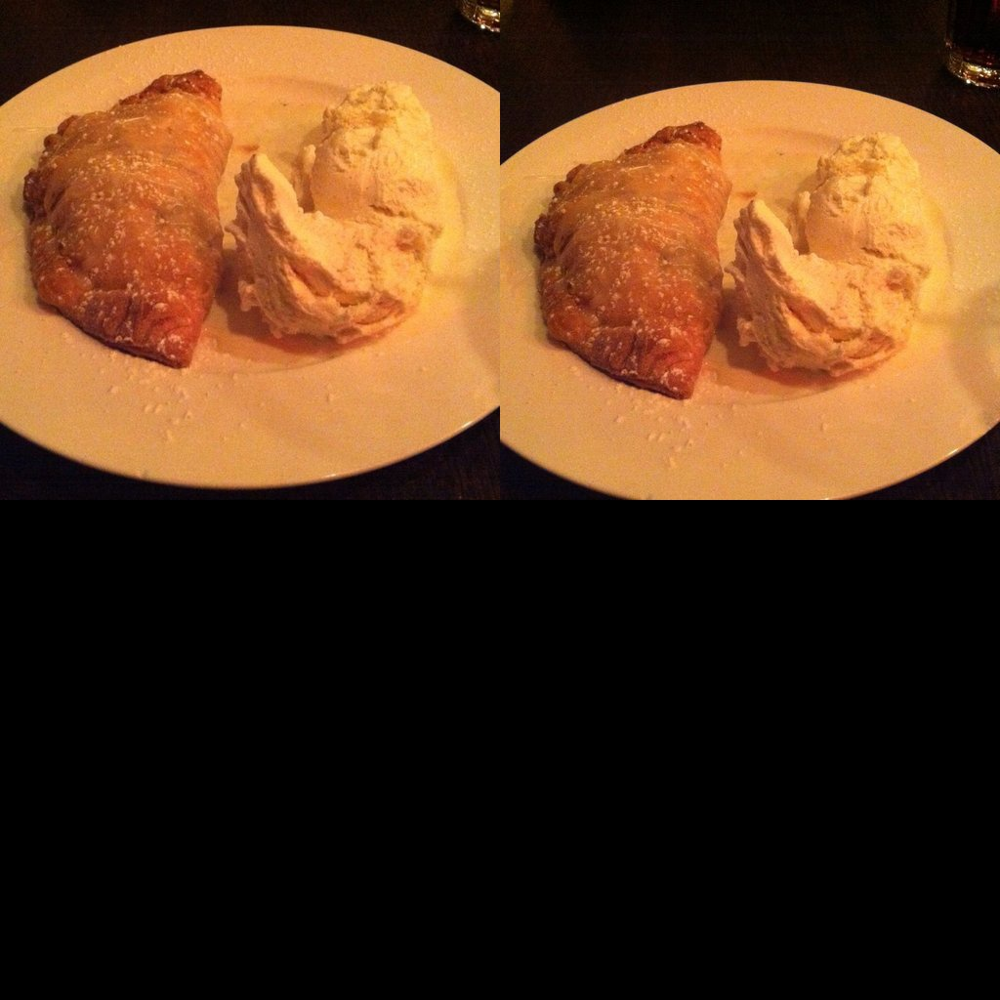
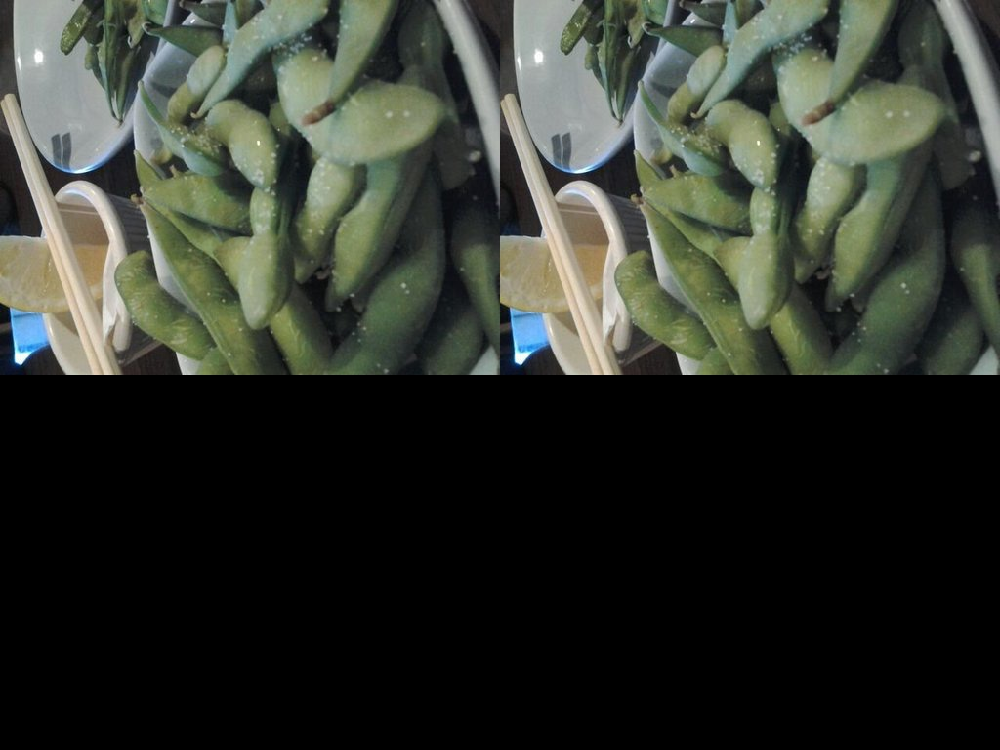
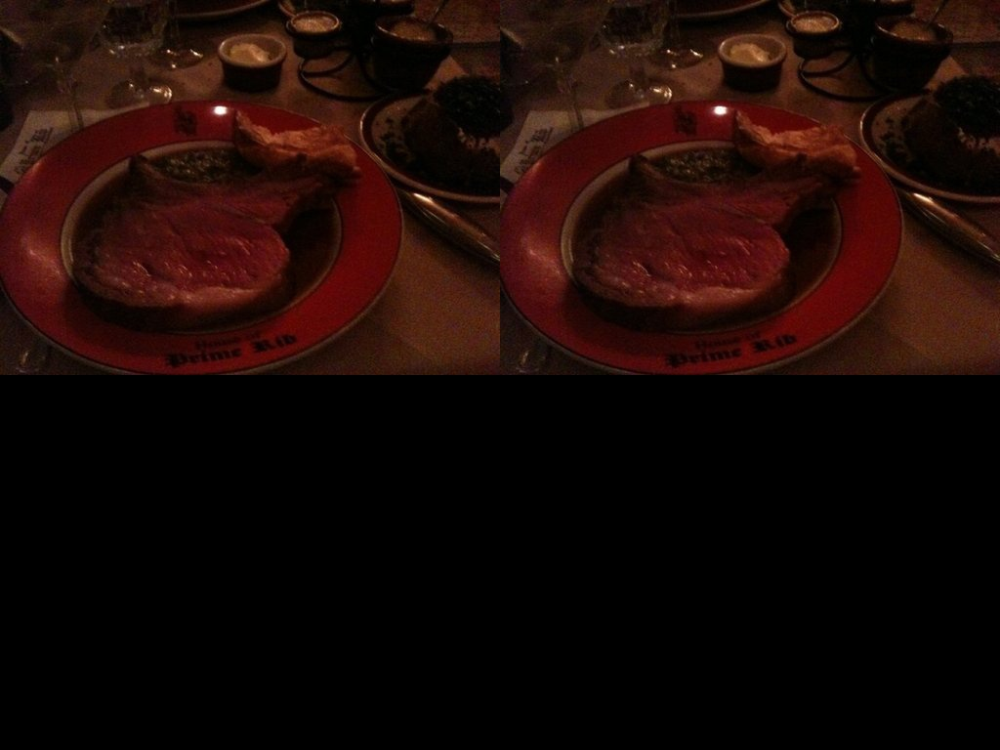
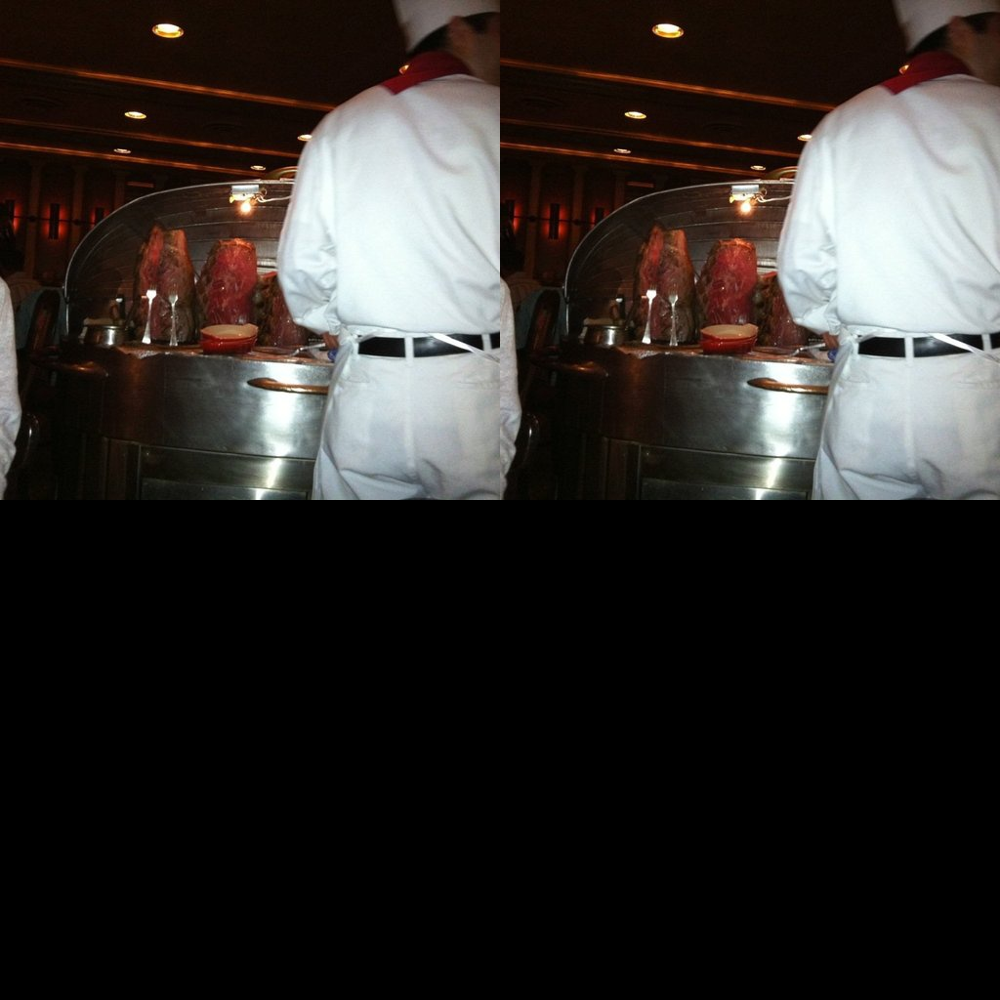

In [11]:
fastdup.create_components_gallery('.','.')
HTML('./components.html')

# Visualize the results with TensorBoard Projector

In [12]:
fastdup.export_to_tensorboard_projector('.','tmp4',900)

Read a total of  101000 images


100%|██████████| 900/900 [00:07<00:00, 122.24it/s]


Finish exporting to tensorboard projector, now run
%load_ext tensorboard
%tensorboard --logdir=tmp4


In [13]:
%load_ext tensorboard


Note: sometimes tensorboard does not boot up on the first call, try to run again in case you see the message "No dashboards are active for the current data set." 

In [15]:
%tensorboard --logdir=tmp4


Reusing TensorBoard on port 6006 (pid 248), started 0:00:28 ago. (Use '!kill 248' to kill it.)

<IPython.core.display.Javascript object>